<a href="https://colab.research.google.com/github/FokrulBhuiyan/Deep-learning-projects/blob/main/DLP_2_suspicious_Activity_Detection_using_YOLOv11.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Mount dataset from kaggle

In [ ]:
# !pip install kaggle

In [ ]:
# from google.colab import files
# files.upload()  # Upload your kaggle.json file here

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"fokrulbhuiyan","key":"6f00727b6ed18aef5b6673e64c6c760e"}'}

In [ ]:

# # Create the .kaggle directory if it doesn't exist
# os.makedirs('/root/.kaggle', exist_ok=True)
# # Move the kaggle.json to the correct location
# os.rename('kaggle.json', '/root/.kaggle/kaggle.json')


In [ ]:
# !kaggle datasets download -d "manhnh123/action-detectionnormalstealingpeakingsneaking" -p "/content/drive/MyDrive/30 Days DL/DLP-2 suspicious Activity Detection/dataset"


Dataset URL: https://www.kaggle.com/datasets/manhnh123/action-detectionnormalstealingpeakingsneaking
License(s): unknown
 99% 837M/849M [00:12<00:00, 56.5MB/s]
100% 849M/849M [00:12<00:00, 69.1MB/s]


In [ ]:
# import zipfile

# # Path to the downloaded zip file
# zip_path = "/content/drive/MyDrive/30 Days DL/DLP-2 suspicious Activity Detection/dataset/action-detectionnormalstealingpeakingsneaking.zip"

# # Extract to a desired directory on Google Drive
# extract_path = '/content/drive/MyDrive/30 Days DL/DLP-2 suspicious Activity Detection/dataset'

# # Extract the files
# with zipfile.ZipFile(zip_path, 'r') as zip_ref:
#     zip_ref.extractall(extract_path)

# print(f"Dataset extracted to: {extract_path}")


Dataset extracted to: /content/drive/MyDrive/30 Days DL/DLP-2 suspicious Activity Detection/dataset


## Dataset prepocessing

### Packages

In [ ]:
import os
import pandas as pd
import numpy as np
import random
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_theme(style="ticks")


In [ ]:
# Define the root directory where you want to start the count
base_path = '/content/drive/MyDrive/30 Days DL/DLP-2 suspicious Activity Detection/dataset'

print(os.listdir(base_path))

TRAIN_DIR = os.path.join(base_path, 'train')
print(os.listdir(TRAIN_DIR))

TEST_DIR = os.path.join(base_path, 'test')
print(os.listdir(TRAIN_DIR))

# Function to count files and subdirectories
def count_files_in_subfolders(root_dir):
    # Iterate through each folder in the root directory
    for foldername, subfolders, filenames in os.walk(root_dir):
        # Skip the root directory itself and show counts for subfolders only
        if foldername != root_dir:
            num_files = len(filenames)
            print(f"Folder: {foldername}")
            print(f"  Files count: {num_files}")
            print(f"  Subfolders count: {len(subfolders)}")
            print('-' * 50)

# Call the function
count_files_in_subfolders(TRAIN_DIR)
count_files_in_subfolders(TEST_DIR)

['action-detectionnormalstealingpeakingsneaking.zip', 'test', 'train']
['Normal', 'Peaking', 'Sneaking', 'Stealing']
['Normal', 'Peaking', 'Sneaking', 'Stealing']
Folder: /content/drive/MyDrive/30 Days DL/DLP-2 suspicious Activity Detection/dataset/train/Normal
  Files count: 1193
  Subfolders count: 0
--------------------------------------------------
Folder: /content/drive/MyDrive/30 Days DL/DLP-2 suspicious Activity Detection/dataset/train/Peaking
  Files count: 1117
  Subfolders count: 0
--------------------------------------------------
Folder: /content/drive/MyDrive/30 Days DL/DLP-2 suspicious Activity Detection/dataset/train/Sneaking
  Files count: 983
  Subfolders count: 0
--------------------------------------------------
Folder: /content/drive/MyDrive/30 Days DL/DLP-2 suspicious Activity Detection/dataset/train/Stealing
  Files count: 1275
  Subfolders count: 0
--------------------------------------------------
Folder: /content/drive/MyDrive/30 Days DL/DLP-2 suspicious Activi

In [ ]:
cell_types = ['Normal', 'Peaking', 'Sneaking', 'Stealing']
data = []

# Define the maximum number of images per class
max_images_per_class = 950

# Set a random seed for reproducibility
random.seed(42)

# Iterate over each cell type
for cell_type in cell_types:
    folder_path = os.path.join(TRAIN_DIR, cell_type)

    # Check if the folder exists
    if os.path.exists(folder_path):
        # List all files in the folder
        files = [
            file for file in os.listdir(folder_path)
            if os.path.isfile(os.path.join(folder_path, file))
        ]

        # Determine the number of files to sample
        if len(files) > max_images_per_class:
            sampled_files = random.sample(files, max_images_per_class)
            print(f"Sampling {max_images_per_class} from {cell_type} (Total: {len(files)})")
        else:
            sampled_files = files
            print(f"Using all {len(files)} from {cell_type}")

        # Append the sampled file paths and labels to the data list
        for file in sampled_files:
            file_path = os.path.join(folder_path, file)
            data.append({"Image_Path": file_path, "Label": cell_type})
    else:
        print(f"Folder not found: {folder_path}")

# Create a DataFrame from the collected data
df = pd.DataFrame(data)

# Display the first few rows of the DataFrame
print("\nSample of the DataFrame:")
print(df.head())

print("\nNumber of samples per class:")
print(df['Label'].value_counts())

Sampling 950 from Normal (Total: 1193)
Sampling 950 from Peaking (Total: 1117)
Sampling 950 from Sneaking (Total: 983)
Sampling 950 from Stealing (Total: 1275)

Sample of the DataFrame:
                                          Image_Path   Label
0  /content/drive/MyDrive/30 Days DL/DLP-2 suspic...  Normal
1  /content/drive/MyDrive/30 Days DL/DLP-2 suspic...  Normal
2  /content/drive/MyDrive/30 Days DL/DLP-2 suspic...  Normal
3  /content/drive/MyDrive/30 Days DL/DLP-2 suspic...  Normal
4  /content/drive/MyDrive/30 Days DL/DLP-2 suspic...  Normal

Number of samples per class:
Label
Normal      950
Peaking     950
Sneaking    950
Stealing    950
Name: count, dtype: int64


In [ ]:
df.tail()


,Image_Path,Label
3795,/content/drive/MyDrive/30 Days DL/DLP-2 suspic...,Stealing
3796,/content/drive/MyDrive/30 Days DL/DLP-2 suspic...,Stealing
3797,/content/drive/MyDrive/30 Days DL/DLP-2 suspic...,Stealing
3798,/content/drive/MyDrive/30 Days DL/DLP-2 suspic...,Stealing
3799,/content/drive/MyDrive/30 Days DL/DLP-2 suspic...,Stealing


In [ ]:
df.shape

(3800, 2)

In [ ]:
df.columns

Index(['Image_Path', 'Label'], dtype='object')

In [ ]:
df.duplicated().sum()

0

In [ ]:
df.isnull().sum()

,0
Image_Path,0
Label,0


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3800 entries, 0 to 3799
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Image_Path  3800 non-null   object
 1   Label       3800 non-null   object
dtypes: object(2)
memory usage: 59.5+ KB


In [ ]:
df.nunique()


,0
Image_Path,3800
Label,4


<ipython-input-11-94284d9aa90a>:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, x="Label",


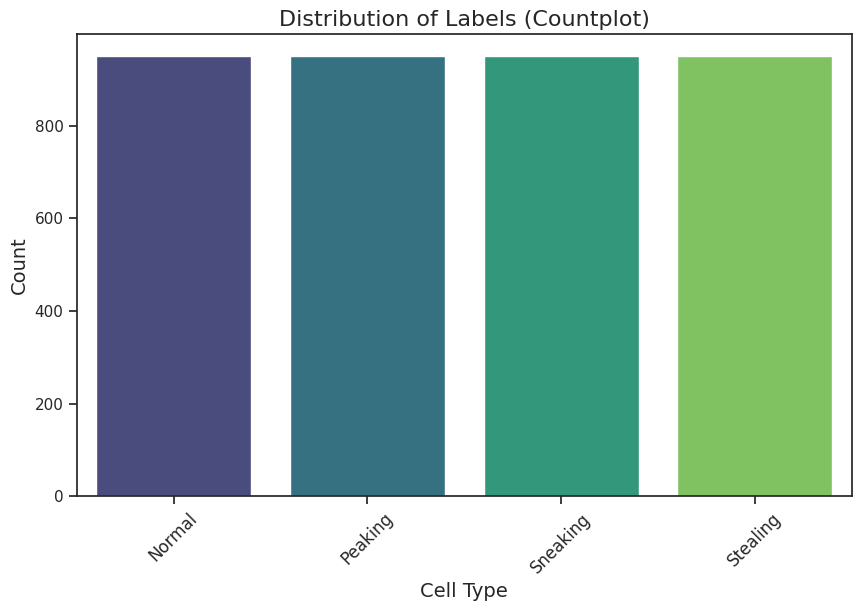

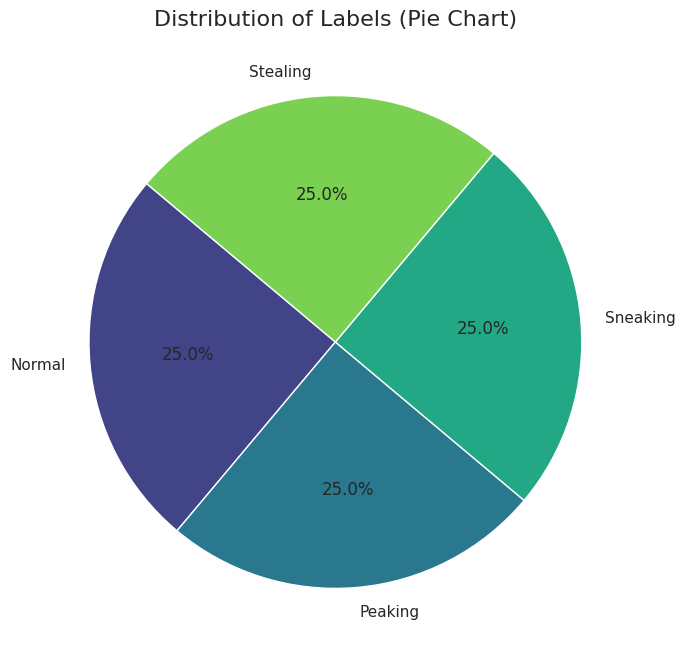

In [ ]:
plt.figure(figsize=(10, 6))
sns.countplot(data=df, x="Label",
order=df['Label'].value_counts().index, palette="viridis")
plt.title("Distribution of Labels (Countplot)", fontsize=16)
plt.xlabel("Cell Type", fontsize=14)
plt.ylabel("Count", fontsize=14)
plt.xticks(rotation=45, fontsize=12)
plt.show()
plt.figure(figsize=(8, 8))
df['Label'].value_counts().plot.pie(
 autopct='%1.1f%%', startangle=140,
colors=sns.color_palette("viridis", len(df['Label'].unique()))
)
plt.title("Distribution of Labels (Pie Chart)", fontsize=16)
plt.ylabel("")
plt.show()

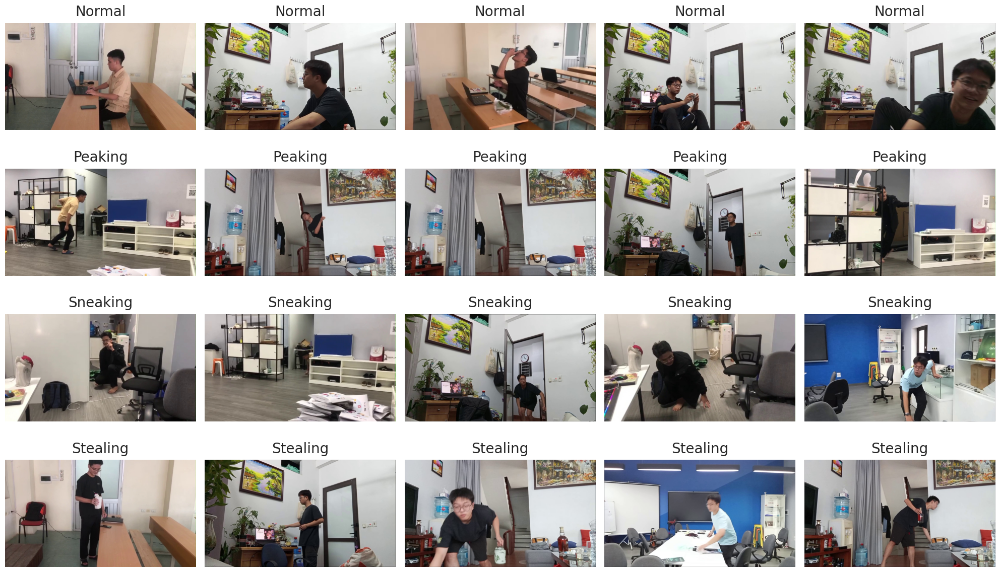

In [ ]:
import cv2
# samples_per_category = 5
# plt.figure(figsize=(20, len(df['Label'].unique()) * 3))
# for idx, label in enumerate(df['Label'].unique()):
#   sample_images = df[df['Label'] == label].sample(n=samples_per_category, random_state=42)

#   for i, img_path in enumerate(sample_images['Image_Path']):
#     img = cv2.imread(img_path)
#     img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

#     plt.subplot(len(df['Label'].unique()), samples_per_category, idx * samples_per_category + i + 1)
#     plt.imshow(img)
#     plt.axis('off')
#     if i == 0:
#       plt.ylabel(label, fontsize=14)
# plt.tight_layout()
# plt.show()
samples_per_category = 5
unique_labels = df['Label'].unique()
num_labels = len(unique_labels)

# Adjust the figure size: width = samples_per_category * 4, height = num_labels * 3
plt.figure(figsize=(samples_per_category * 4, num_labels * 3))

for idx, label in enumerate(unique_labels):
    # Sample 'samples_per_category' images per label
    sample_images = df[df['Label'] == label].sample(n=samples_per_category, random_state=42)

    for i, img_path in enumerate(sample_images['Image_Path']):
        # Read the image using OpenCV
        img = cv2.imread(img_path)
        if img is None:
            print(f"Warning: Unable to read image at path: {img_path}")
            continue  # Skip to the next image if reading fails

        # Convert BGR (OpenCV format) to RGB (Matplotlib format)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Create a subplot for each image
        ax = plt.subplot(num_labels, samples_per_category, idx * samples_per_category + i + 1)
        ax.imshow(img)
        ax.axis('off')  # Hide axis ticks and labels

        # Add the label as the title above each image
        ax.set_title(label, fontsize=20, pad=10)  # 'pad' adjusts the spacing between title and image

plt.tight_layout()
plt.show()

## Model Analysis

In [ ]:
!pip install ultralytics
from ultralytics import YOLO
from PIL import Image
from tqdm.notebook import tqdm

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 905.3/905.3 kB 24.7 MB/s eta 0:00:00
Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
CONF_THRESHOLD = 0.25
BATCH_SIZE = 16
IMG_SIZE = 640
CLASSES = ['Normal', 'Peaking', 'Sneaking', 'Stealing']
model = YOLO('/content/drive/MyDrive/30 Days DL/DLP-2 suspicious Activity Detection/model/yolo11l.pt')
print("Model loaded successfully!")


Model loaded successfully!



Testing one image per class with different confidence thresholds...

Confidence Threshold: 0.25

Processing class 'Normal' with image'Normal_4.jpg':

0: 384x640 1 person, 1 parking meter, 1 backpack, 376.3ms
Speed: 15.2ms preprocess, 376.3ms inference, 1499.0ms postprocess per image at shape (1, 3, 384, 640)
Detected backpack (Confidence: 0.88)
Detected person (Confidence: 0.78)
Detected parking meter (Confidence: 0.34)


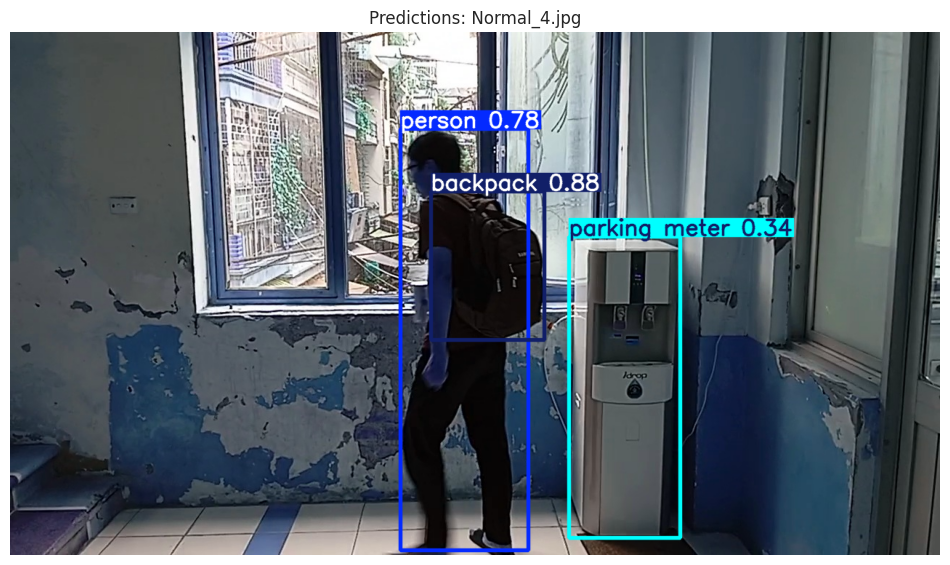


Processing class 'Peaking' with image'Peaking_35.jpg':

0: 384x640 1 person, 1 backpack, 31.5ms
Speed: 2.0ms preprocess, 31.5ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)
Detected person (Confidence: 0.88)
Detected backpack (Confidence: 0.79)


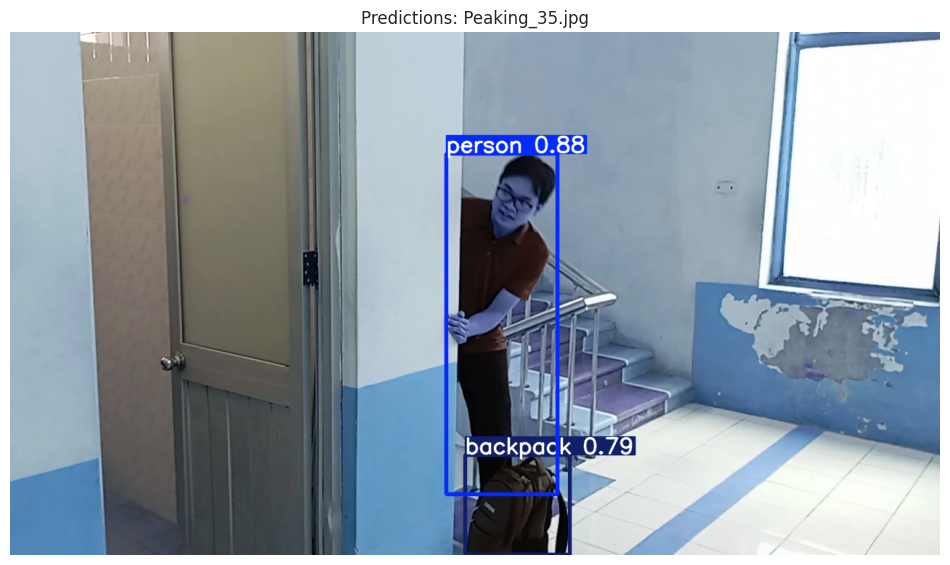


Processing class 'Sneaking' with image'Sneaking_15.jpg':

0: 384x640 1 person, 31.2ms
Speed: 2.0ms preprocess, 31.2ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)
Detected person (Confidence: 0.96)


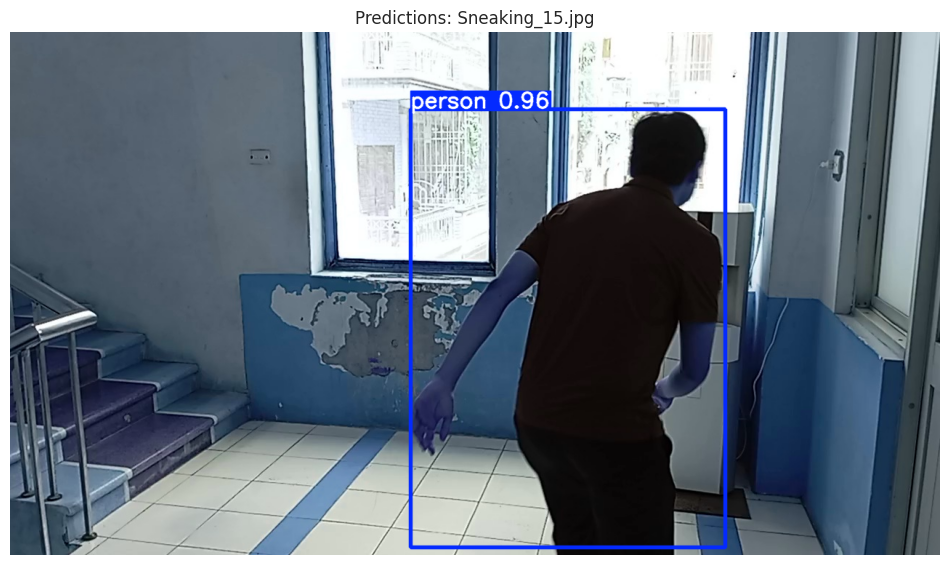


Processing class 'Stealing' with image'Stealing_88.jpg':

0: 384x640 1 person, 1 backpack, 1 refrigerator, 31.2ms
Speed: 2.6ms preprocess, 31.2ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)
Detected person (Confidence: 0.91)
Detected backpack (Confidence: 0.81)
Detected refrigerator (Confidence: 0.65)


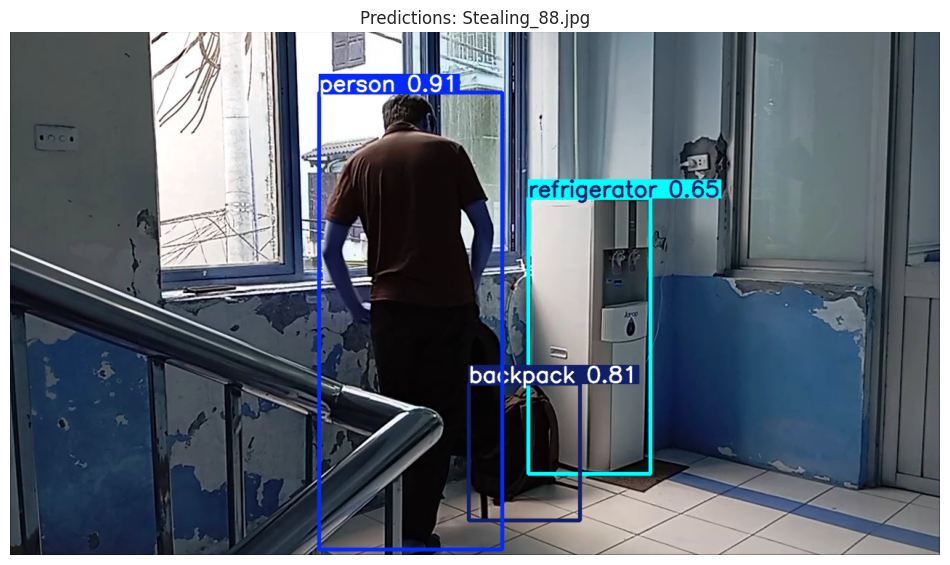


Confidence Threshold: 0.5

Processing class 'Normal' with image'Normal_59.jpg':

0: 384x640 1 person, 45.2ms
Speed: 3.4ms preprocess, 45.2ms inference, 3.9ms postprocess per image at shape (1, 3, 384, 640)
Detected person (Confidence: 0.95)


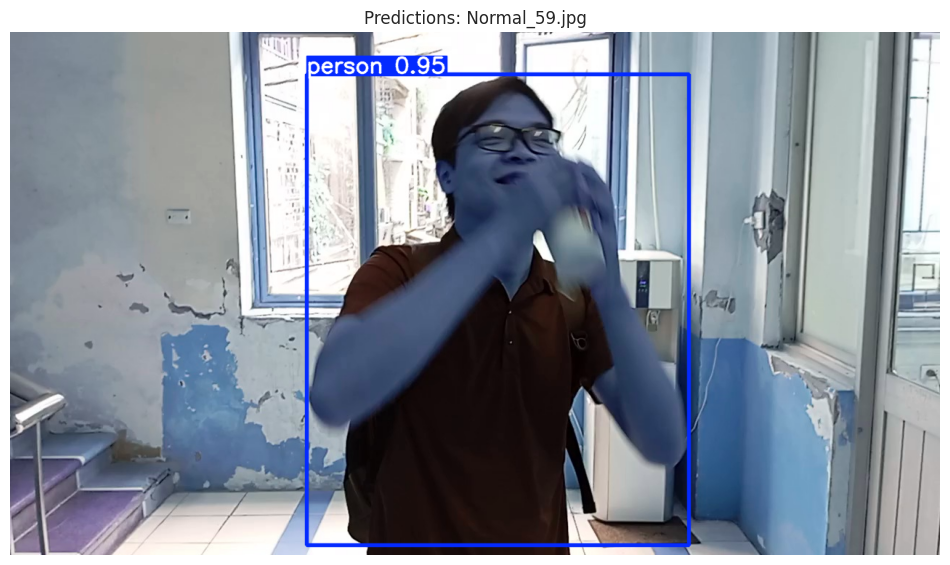


Processing class 'Peaking' with image'Peaking_116.jpg':

0: 384x640 1 person, 1 backpack, 108.6ms
Speed: 21.4ms preprocess, 108.6ms inference, 4.2ms postprocess per image at shape (1, 3, 384, 640)
Detected person (Confidence: 0.93)
Detected backpack (Confidence: 0.87)


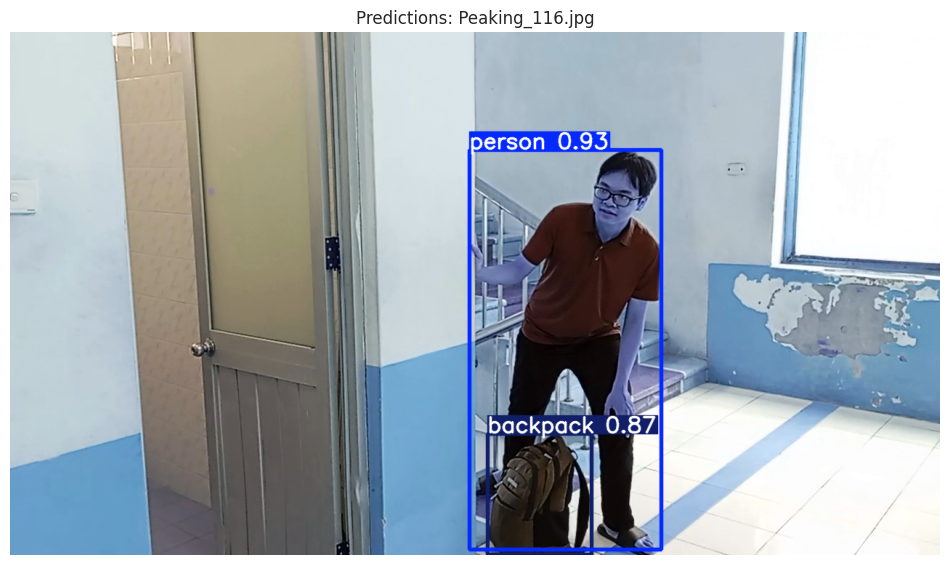


Processing class 'Sneaking' with image'Sneaking_80.jpg':

0: 384x640 1 person, 43.0ms
Speed: 2.1ms preprocess, 43.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Detected person (Confidence: 0.92)


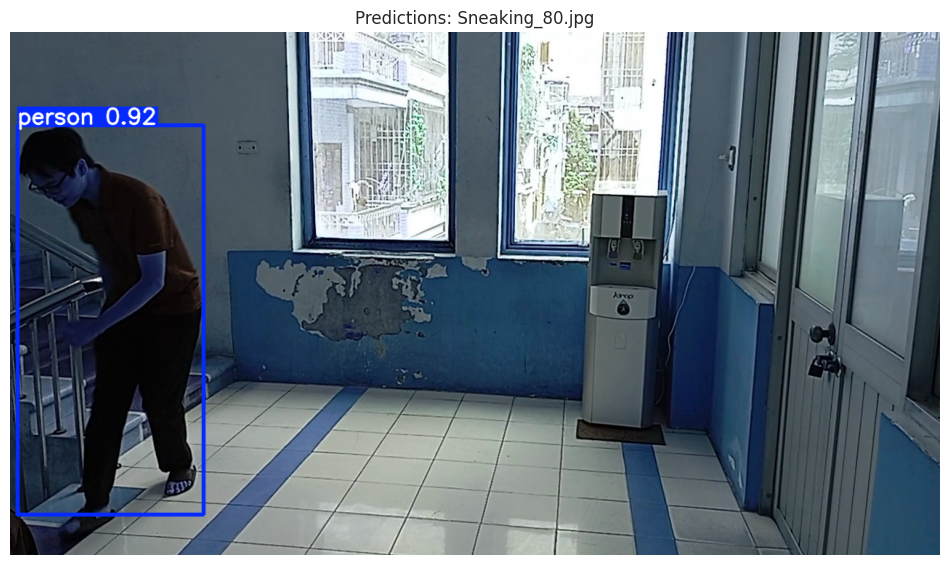


Processing class 'Stealing' with image'Stealing_98.jpg':

0: 384x640 1 person, 1 handbag, 1 refrigerator, 37.2ms
Speed: 2.0ms preprocess, 37.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Detected person (Confidence: 0.90)
Detected refrigerator (Confidence: 0.85)
Detected handbag (Confidence: 0.67)


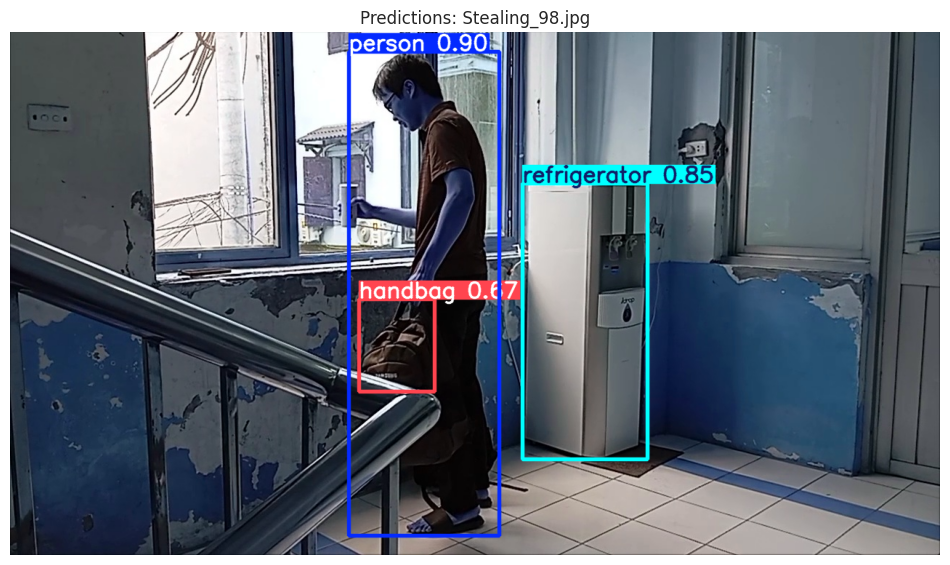


Confidence Threshold: 0.75

Processing class 'Normal' with image'Normal_87.jpg':

0: 384x640 1 person, 1 backpack, 31.2ms
Speed: 2.0ms preprocess, 31.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Detected person (Confidence: 0.92)
Detected backpack (Confidence: 0.87)


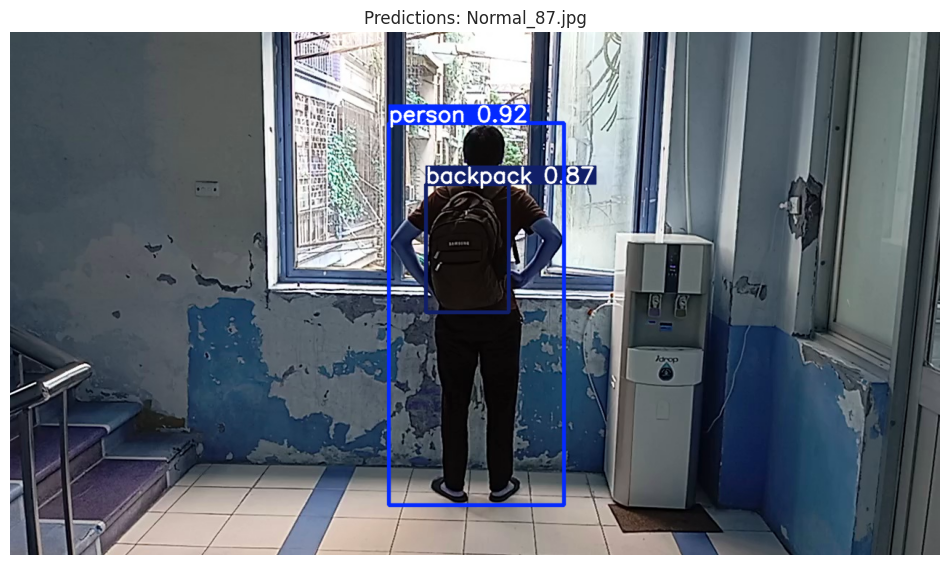


Processing class 'Peaking' with image'Peaking_121.jpg':

0: 384x640 1 person, 1 backpack, 119.2ms
Speed: 4.1ms preprocess, 119.2ms inference, 4.2ms postprocess per image at shape (1, 3, 384, 640)
Detected person (Confidence: 0.93)
Detected backpack (Confidence: 0.86)


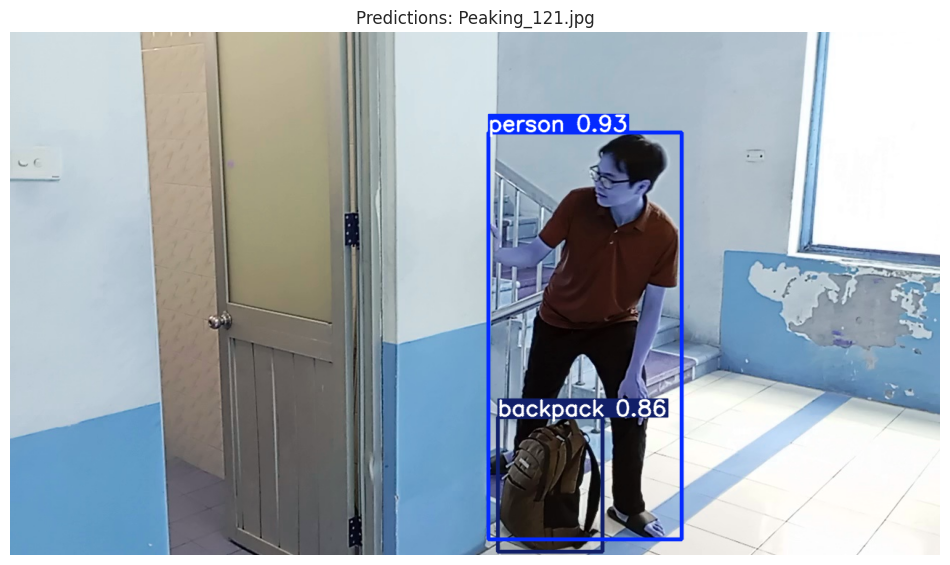


Processing class 'Sneaking' with image'Sneaking_36.jpg':

0: 384x640 1 person, 31.2ms
Speed: 2.1ms preprocess, 31.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Detected person (Confidence: 0.95)


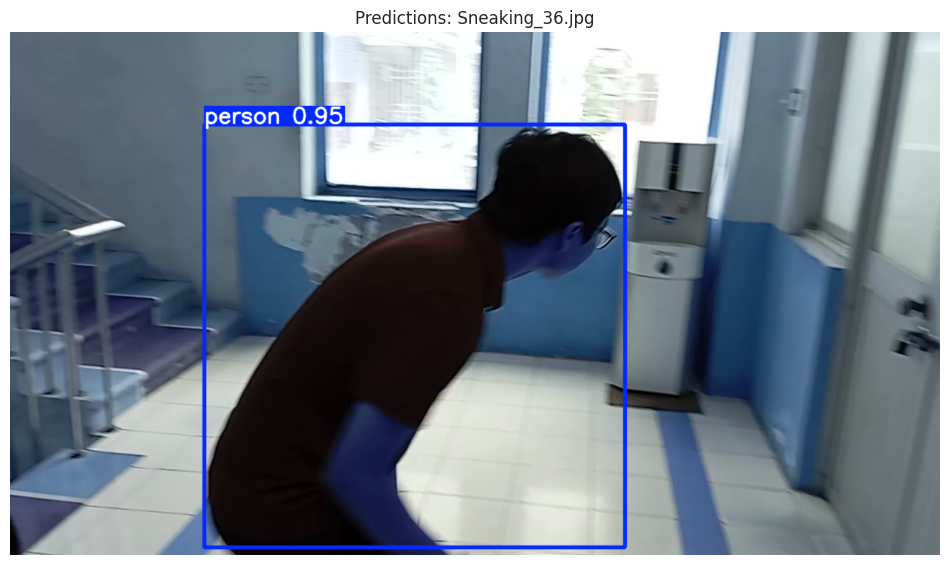


Processing class 'Stealing' with image'Stealing_8.jpg':

0: 384x640 1 person, 1 backpack, 31.3ms
Speed: 2.5ms preprocess, 31.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Detected person (Confidence: 0.93)
Detected backpack (Confidence: 0.86)


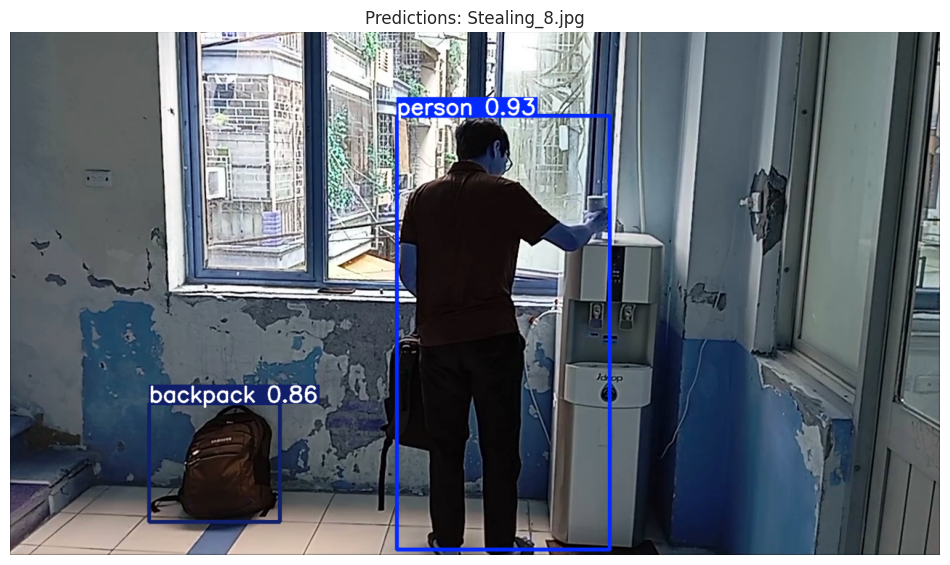

In [ ]:
def predict_and_display(image_path,conf_threshold=CONF_THRESHOLD):
  """Make and display predictions on a single image"""
  img = cv2.imread(image_path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  results = model.predict(source=img,conf=conf_threshold,show=False)
  plt.figure(figsize=(12, 8))
  for r in results:
    im_array = r.plot()
    plt.imshow(cv2.cvtColor(im_array, cv2.COLOR_BGR2RGB))
    plt.title(f"Predictions: {os.path.basename(image_path)}")
    plt.axis('off')
    for box in r.boxes:
      conf = float(box.conf[0])
      cls = int(box.cls[0])
      cls_name = model.names[cls]
      print(f"Detected {cls_name} (Confidence: {conf:.2f})")
  plt.show()

confidence_thresholds = [0.25, 0.5, 0.75]
print("\nTesting one image per class with different confidence thresholds...")

for conf in confidence_thresholds:
  print(f"\nConfidence Threshold: {conf}")
  for class_name in CLASSES:
    test_class_path = os.path.join(TEST_DIR, class_name)
    if os.path.exists(test_class_path):
      images = os.listdir(test_class_path)
      if images:
        sample_image = os.path.join(test_class_path,
        np.random.choice(images))
        print(f"\nProcessing class '{class_name}' with image'{os.path.basename(sample_image)}':")
        predict_and_display(sample_image, conf)

### Batch Processing


Processing a batch of test images...

0: 384x640 1 person, 1 car, 1 backpack, 17.1ms
1: 384x640 1 person, 1 cup, 17.1ms
2: 384x640 1 person, 1 backpack, 1 refrigerator, 17.1ms
3: 384x640 1 person, 1 car, 1 backpack, 17.1ms
4: 384x640 1 person, 1 backpack, 17.1ms
5: 384x640 1 person, 1 backpack, 17.1ms
6: 384x640 1 person, 2 backpacks, 17.1ms
7: 384x640 1 person, 1 bottle, 1 cup, 17.1ms
8: 384x640 1 person, 17.1ms
9: 384x640 1 person, 1 backpack, 17.1ms
10: 384x640 1 person, 1 backpack, 17.1ms
11: 384x640 1 person, 1 backpack, 17.1ms
12: 384x640 1 person, 1 backpack, 17.1ms
13: 384x640 1 person, 1 backpack, 17.1ms
14: 384x640 1 person, 1 backpack, 17.1ms
15: 384x640 1 person, 1 backpack, 17.1ms
16: 384x640 1 person, 17.1ms
17: 384x640 1 person, 17.1ms
18: 384x640 1 person, 17.1ms
19: 384x640 1 person, 17.1ms
20: 384x640 1 person, 17.1ms
21: 384x640 1 person, 17.1ms
22: 384x640 1 person, 17.1ms
23: 384x640 1 person, 1 parking meter, 17.1ms
24: 384x640 1 person, 1 parking meter, 1 backpa

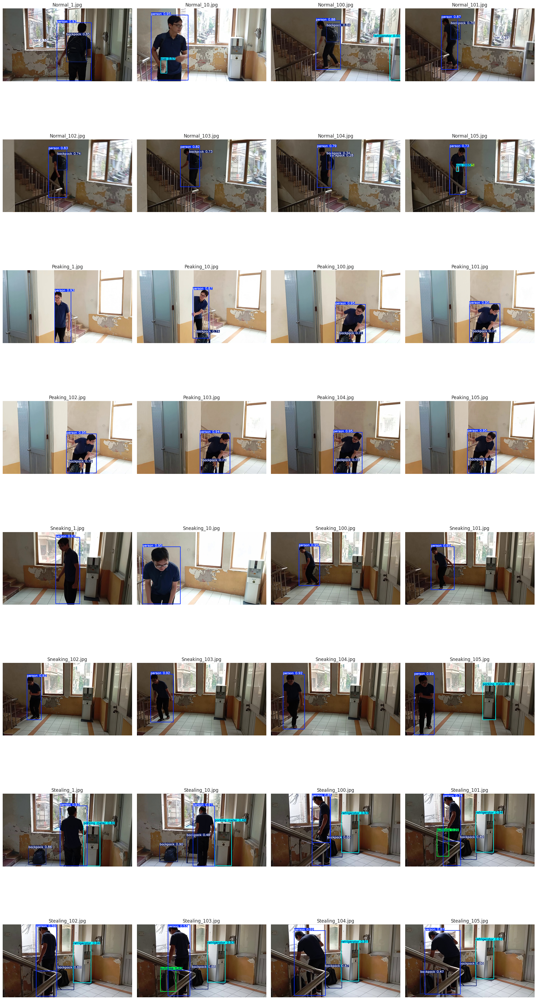


Processed 32 images.


In [ ]:
def process_batch(directory, batch_size=BATCH_SIZE):
  """Process multiple images in a batch and display predictions"""
  image_paths = []
  for class_name in CLASSES:
    class_path = os.path.join(directory, class_name)
    if os.path.exists(class_path):
      class_images = os.listdir(class_path)
      image_paths.extend([os.path.join(class_path, img) for img in class_images[:batch_size]]
  )

  if not image_paths:
    print("No images found for batch processing.")
    return
  results = model(image_paths, conf=CONF_THRESHOLD)
  num_images = len(image_paths)
  grid_cols = 4
  grid_rows = int(np.ceil(num_images / grid_cols))
  plt.figure(figsize=(20, 5 * grid_rows))

  for idx, r in enumerate(results):
    plt.subplot(grid_rows, grid_cols, idx + 1)
    im_array = r.plot()
    plt.imshow(cv2.cvtColor(im_array, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title(f"{os.path.basename(image_paths[idx])}")

  plt.tight_layout()
  plt.show()
  print(f"\nProcessed {num_images} images.")
print("\nProcessing a batch of test images...")
process_batch(TEST_DIR, batch_size=8)


### Analysis


========== SECTION 5: Detection Analysis ==========


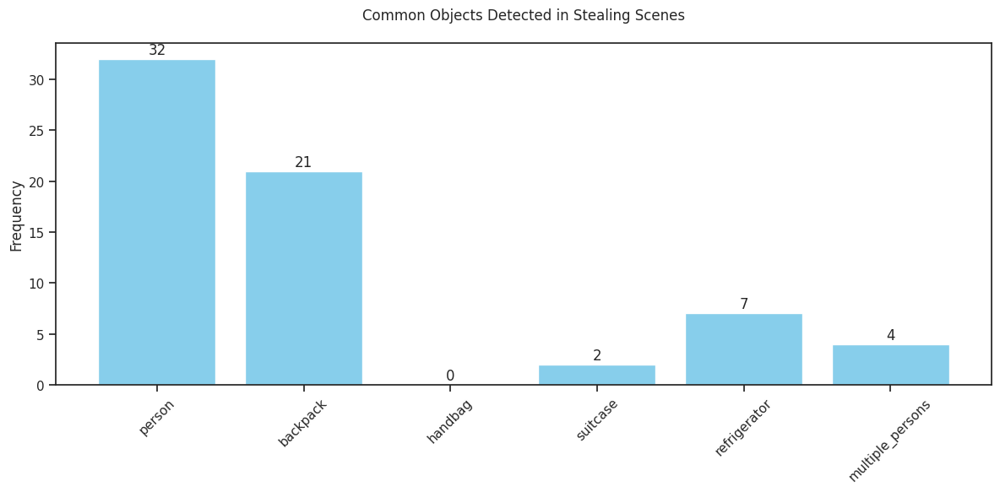


Detection Statistics:
Total images analyzed: 32
person: 32 occurrences (100.0%)
backpack: 21 occurrences (65.6%)
handbag: 0 occurrences (0.0%)
suitcase: 2 occurrences (6.2%)
refrigerator: 7 occurrences (21.9%)
multiple_persons: 4 occurrences (12.5%)

Common Patterns:
- Person with backpack: 21 scenes
- Person with handbag: 0 scenes
- Scenes with refrigerator: 7 scenes

========== SECTION 6: Scene Classification ==========


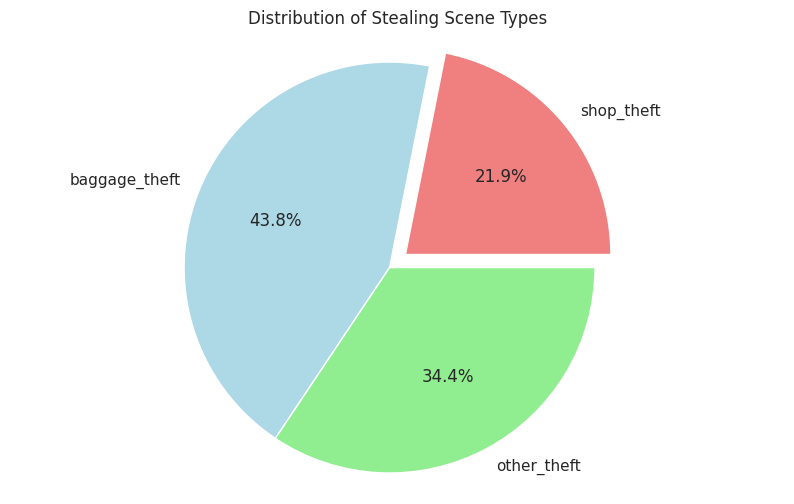


Scene Type Analysis:
shop_theft: 7 scenes
baggage_theft: 14 scenes
other_theft: 11 scenes

Analysis completed!


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter
results = [
  "1 person, 1 car, 1 backpack",
  "1 person, 1 cup",
  "1 person, 1 backpack, 1 refrigerator",
  "1 person, 1 car, 1 backpack",
  "1 person, 1 backpack",
  "1 person, 1 backpack",
  "1 person, 2 backpacks",
  "1 person, 1 bottle, 1 cup",
  "1 person",
  "1 person, 1 backpack",
  "1 person, 1 backpack",
  "1 person, 1 backpack",
  "1 person, 1 backpack",
  "1 person, 1 backpack",
  "1 person, 1 backpack",
  "1 person, 1 backpack",
  "1 person",
  "1 person",
  "1 person",
  "1 person",
  "1 person",
  "1 person",
  "1 person",
  "1 person, 1 parking meter",
  "1 person, 1 parking meter, 1 backpack",
  "1 person, 1 parking meter, 2 backpacks",
  "2 persons, 1 backpack, 1 refrigerator",
  "2 persons, 1 backpack, 1 suitcase, 1 refrigerator",
  "2 persons, 1 backpack, 1 refrigerator",
  "2 persons, 1 backpack, 1 suitcase, 1 refrigerator",
  "1 person, 1 backpack, 1 refrigerator",
  "1 person, 2 backpacks, 1 refrigerator"
]
def analyze_stealing_detections():
  detections = {
    'person': 0,
    'backpack': 0,
    'handbag': 0,
    'suitcase': 0,
    'refrigerator': 0,
    'multiple_persons': 0
  }

  for line in results:
    if 'persons' in line:
      detections['multiple_persons'] += 1
    if 'person' in line:
      detections['person'] += 1
    if 'backpack' in line:
      detections['backpack'] += 1
    if 'handbag' in line:
      detections['handbag'] += 1
    if 'suitcase' in line or 'suitcases' in line:
      detections['suitcase'] += 1
    if 'refrigerator' in line:
      detections['refrigerator'] += 1

  plt.figure(figsize=(12, 6))
  plt.bar(detections.keys(), detections.values(), color='skyblue')
  plt.title('Common Objects Detected in Stealing Scenes', pad=20)
  plt.xticks(rotation=45)
  plt.ylabel('Frequency')
  for i, v in enumerate(detections.values()):
    plt.text(i, v + 0.5, str(v), ha='center')
  plt.tight_layout()
  plt.show()

  print("\nDetection Statistics:")
  total_images = len(results)
  print(f"Total images analyzed: {total_images}")
  for obj, count in detections.items():
    percentage = (count / total_images) * 100
    print(f"{obj}: {count} occurrences ({percentage:.1f}%)")

  print("\nCommon Patterns:")
  backpack_with_person = sum(1 for line in results if 'person' in
  line and 'backpack' in line)
  handbag_with_person = sum(1 for line in results if 'person' in
  line and 'handbag' in line)
  refrigerator_scenes = sum(1 for line in results if 'refrigerator'
  in line)

  print(f"- Person with backpack: {backpack_with_person} scenes")
  print(f"- Person with handbag: {handbag_with_person} scenes")
  print(f"- Scenes with refrigerator: {refrigerator_scenes} scenes")
def classify_stealing_scenes():
  scene_types = {
  'shop_theft': 0,
  'baggage_theft': 0,
  'other_theft': 0
  }

  for line in results:
    if 'refrigerator' in line:
      scene_types['shop_theft'] += 1
    elif any(item in line for item in ['backpack', 'handbag','suitcase', 'suitcases']):
      scene_types['baggage_theft'] += 1
    else:
      scene_types['other_theft'] += 1

  plt.figure(figsize=(10, 6))
  colors = ['lightcoral', 'lightblue', 'lightgreen']
  plt.pie(scene_types.values(), labels=scene_types.keys(),autopct='%1.1f%%',colors=colors, explode=(0.1, 0, 0))
  plt.title('Distribution of Stealing Scene Types')
  plt.axis('equal')
  plt.show()

  print("\nScene Type Analysis:")
  for scene_type, count in scene_types.items():
    print(f"{scene_type}: {count} scenes")

print("\n========== SECTION 5: Detection Analysis ==========")
analyze_stealing_detections()
print("\n========== SECTION 6: Scene Classification ==========")
classify_stealing_scenes()
print("\nAnalysis completed!")

### Live Test on New Image



Testing suspicious_action1:
Image downloaded successfully

image 1/1 /content/test_suspicious_action1.jpg: 480x640 2 persons, 1 handbag, 60.2ms
Speed: 2.7ms preprocess, 60.2ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


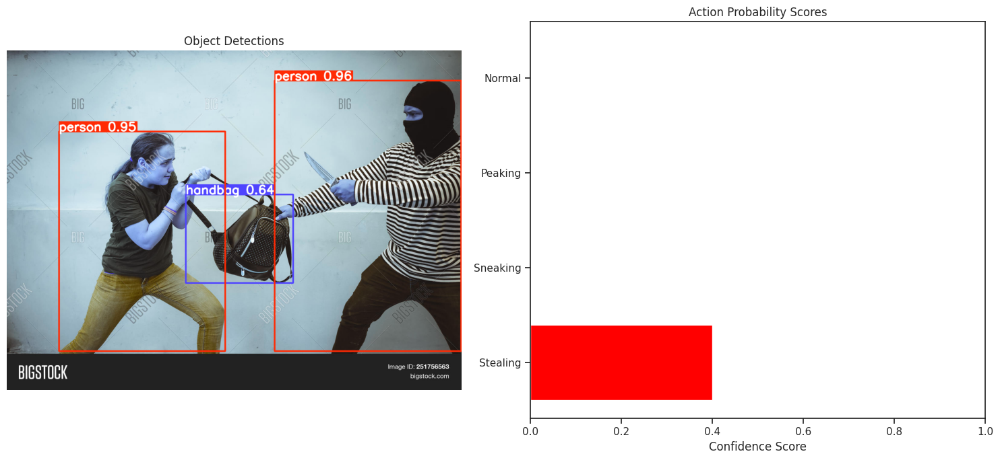


Detected Objects:
- person: 96.08% confidence
- person: 95.05% confidence
- handbag: 64.13% confidence

Action Analysis:
Predicted Action: Stealing(40.00% confidence)

All Action Scores:
- Stealing: 40.00%
- Sneaking: 0.00%
- Peaking: 0.00%
- Normal: 0.00%

Testing suspicious_action2:
Image downloaded successfully

image 1/1 /content/test_suspicious_action2.jpg: 448x640 1 person, 52.2ms
Speed: 3.1ms preprocess, 52.2ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)


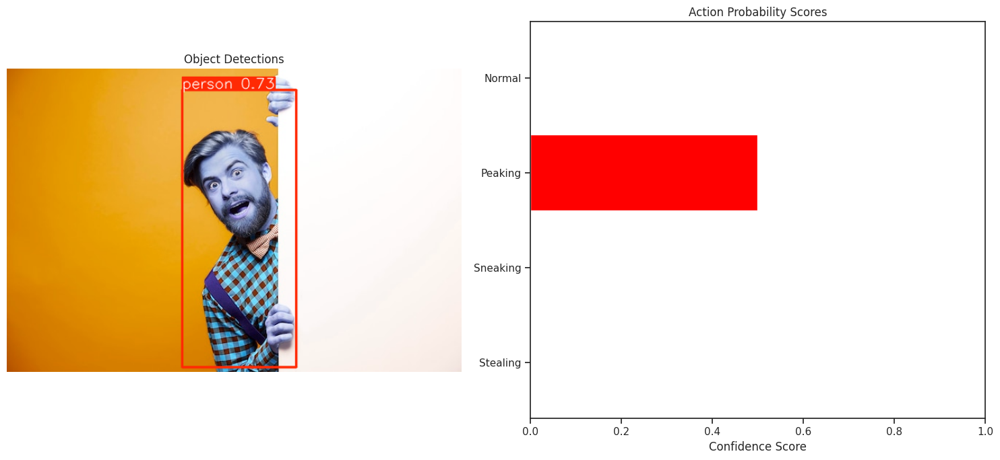


Detected Objects:
- person: 72.68% confidence

Action Analysis:
Predicted Action: Peaking(50.00% confidence)

All Action Scores:
- Stealing: 0.00%
- Sneaking: 0.00%
- Peaking: 50.00%
- Normal: 0.00%

Action detection testing completed!


In [ ]:
import urllib.request
import os
import numpy as np
import cv2
import matplotlib.pyplot as plt

def detect_action(model, image_path):
  results = model.predict(source=image_path, conf=0.25, save=False)
  result = results[0]

  detections = [(model.names[int(box.cls[0])], float(box.conf[0]))for box in result.boxes]

  def classify_action(detections):
    detected_objects = [d[0] for d in detections]

    action_scores = {
    'Stealing': 0.0,
    'Sneaking': 0.0,
    'Peaking': 0.0,
    'Normal': 0.0
    }
    if 'person' in detected_objects:
      if any(obj in detected_objects for obj in ['backpack', 'handbag', 'suitcase']):
        action_scores['Stealing'] += 0.4
      if 'refrigerator' in detected_objects:
        action_scores['Stealing'] += 0.3
      if [conf for obj, conf in detections if obj == 'person'][0] < 0.6:
        action_scores['Sneaking'] += 0.5
      if len(detected_objects) <= 2:
        action_scores['Peaking'] += 0.5

    if not any(score > 0.3 for score in action_scores.values()):
      action_scores['Normal'] = 0.4

    return action_scores
  action_scores = classify_action(detections)
  plt.figure(figsize=(15, 7))
  plt.subplot(1, 2, 1)
  img = cv2.imread(image_path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  plt.imshow(result.plot())
  plt.title('Object Detections')
  plt.axis('off')
  plt.subplot(1, 2, 2)
  actions = list(action_scores.keys())
  scores = list(action_scores.values())
  colors = ['red' if score == max(scores) else 'blue' for score in scores]

  plt.barh(actions, scores, color=colors)
  plt.title('Action Probability Scores')
  plt.xlabel('Confidence Score')
  plt.xlim(0, 1)
  plt.tight_layout()
  plt.show()

  print("\nDetected Objects:")
  for obj, conf in detections:
    print(f"- {obj}: {conf:.2%} confidence")

  print("\nAction Analysis:")
  predicted_action = max(action_scores.items(), key=lambda x: x[1])
  print(f"Predicted Action: {predicted_action[0]}({predicted_action[1]:.2%} confidence)")
  print("\nAll Action Scores:")
  for action, score in action_scores.items():
    print(f"- {action}: {score:.2%}")

test_urls = {'suspicious_action1':'https://static1.bigstockphoto.com/1/5/2/large1500/251756563.jpg',
             'suspicious_action2':'https://img.freepik.com/free-photo/portrait-shocked-manpeeking_329181-19905.jpg',
}

for name, url in test_urls.items():
 try:
  print(f"\nTesting {name}:")
  image_path = f'test_{name}.jpg'

  opener = urllib.request.build_opener()
  opener.addheaders = [('User-Agent', 'Mozilla/5.0')]
  urllib.request.install_opener(opener)

  urllib.request.urlretrieve(url, image_path)
  print("Image downloaded successfully")

  detect_action(model, image_path)

  os.remove(image_path)

 except Exception as e:
  print(f"Error processing {url}: {str(e)}")

print("\nAction detection testing completed!")


Testing Normal:

image 1/1 /content/drive/MyDrive/30 Days DL/DLP-2 suspicious Activity Detection/dataset/test/Normal/Normal_10.jpg: 384x640 1 person, 1 cup, 37.0ms
Speed: 2.8ms preprocess, 37.0ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


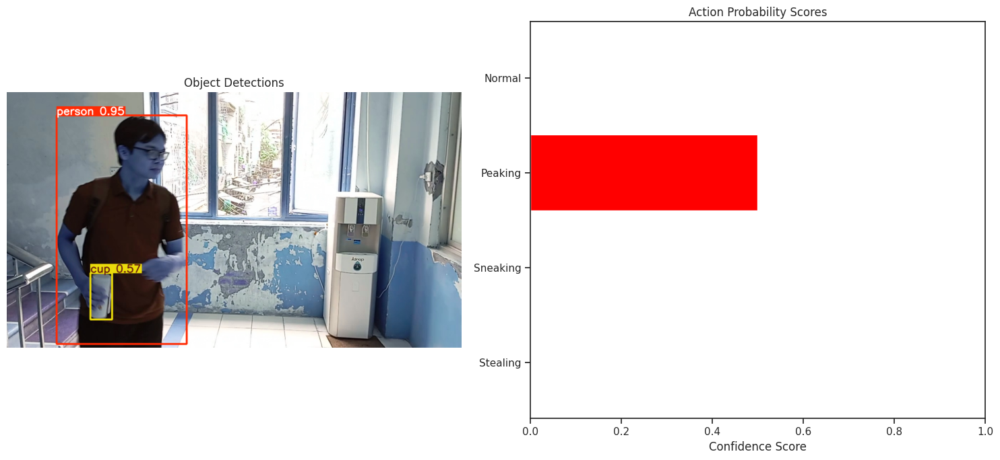


Detected Objects:
- person: 95.09% confidence
- cup: 56.65% confidence

Action Analysis:
Predicted Action: Peaking(50.00% confidence)

All Action Scores:
- Stealing: 0.00%
- Sneaking: 0.00%
- Peaking: 50.00%
- Normal: 0.00%

Testing Peaking:

image 1/1 /content/drive/MyDrive/30 Days DL/DLP-2 suspicious Activity Detection/dataset/test/Peaking/Peaking_10.jpg: 384x640 1 person, 1 backpack, 31.2ms
Speed: 2.7ms preprocess, 31.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


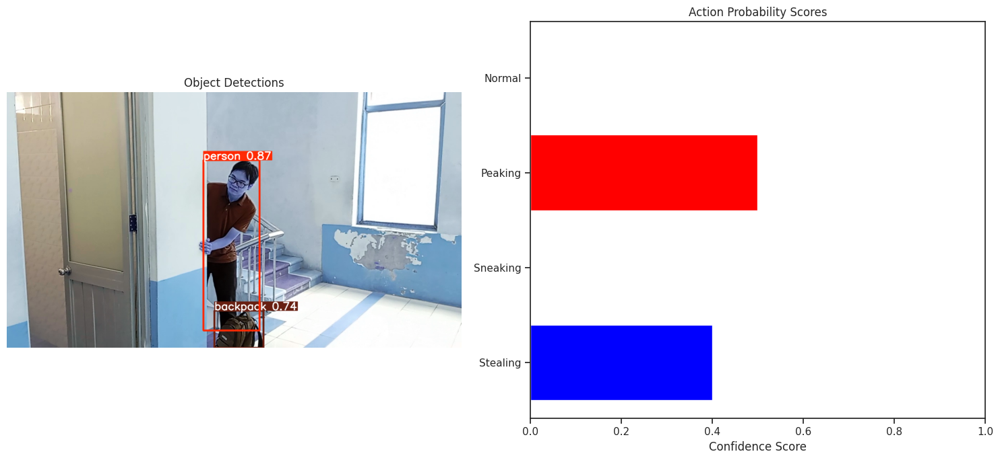


Detected Objects:
- person: 86.54% confidence
- backpack: 73.66% confidence

Action Analysis:
Predicted Action: Peaking(50.00% confidence)

All Action Scores:
- Stealing: 40.00%
- Sneaking: 0.00%
- Peaking: 50.00%
- Normal: 0.00%

Testing Sneaking:

image 1/1 /content/drive/MyDrive/30 Days DL/DLP-2 suspicious Activity Detection/dataset/test/Sneaking/Sneaking_10.jpg: 384x640 1 person, 33.9ms
Speed: 2.0ms preprocess, 33.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


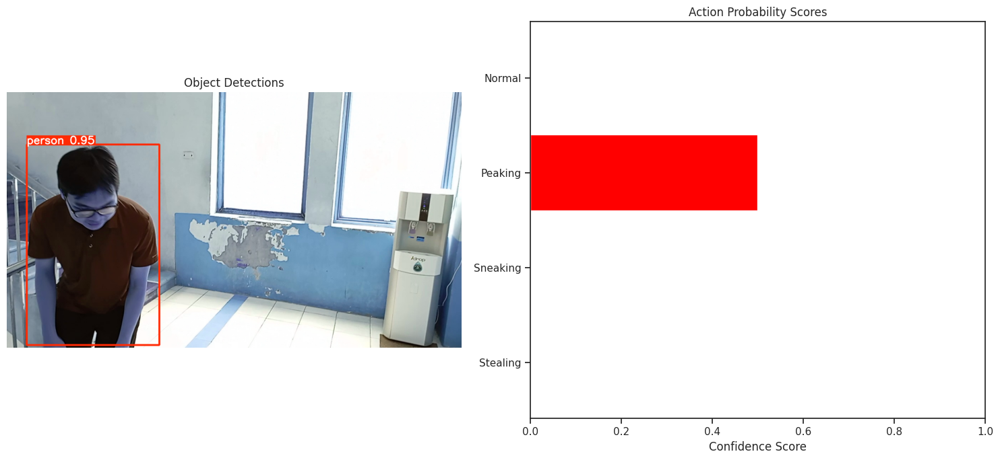


Detected Objects:
- person: 95.20% confidence

Action Analysis:
Predicted Action: Peaking(50.00% confidence)

All Action Scores:
- Stealing: 0.00%
- Sneaking: 0.00%
- Peaking: 50.00%
- Normal: 0.00%

Testing Stealing:

image 1/1 /content/drive/MyDrive/30 Days DL/DLP-2 suspicious Activity Detection/dataset/test/Stealing/Stealing_10.jpg: 384x640 1 person, 1 parking meter, 2 backpacks, 31.2ms
Speed: 2.0ms preprocess, 31.2ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


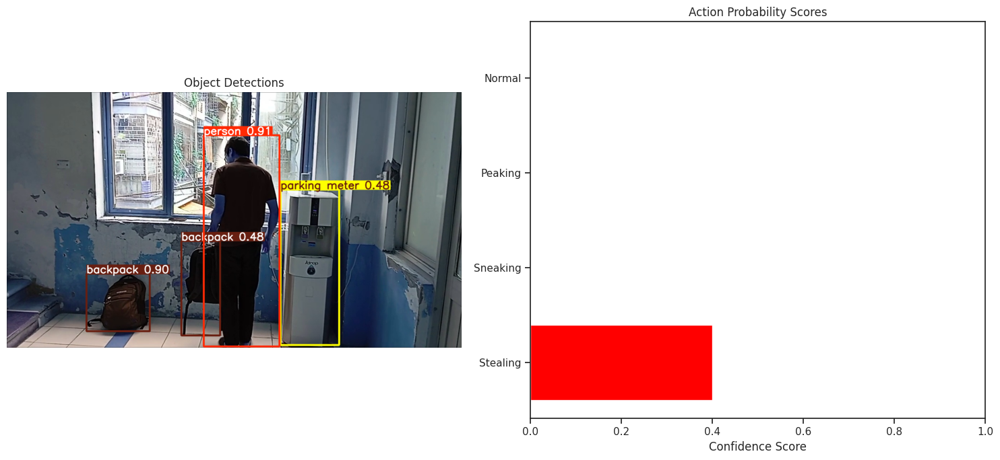


Detected Objects:
- person: 91.24% confidence
- backpack: 89.61% confidence
- parking meter: 47.78% confidence
- backpack: 47.66% confidence

Action Analysis:
Predicted Action: Stealing(40.00% confidence)

All Action Scores:
- Stealing: 40.00%
- Sneaking: 0.00%
- Peaking: 0.00%
- Normal: 0.00%

Action detection testing completed!


In [ ]:
def detect_action(model, image_path):
  results = model.predict(source=image_path, conf=0.25, save=False)
  result = results[0]

  detections = [(model.names[int(box.cls[0])], float(box.conf[0]))for box in result.boxes]

  def classify_action(detections):
    detected_objects = [d[0] for d in detections]

    action_scores = {
    'Stealing': 0.0,
    'Sneaking': 0.0,
    'Peaking': 0.0,
    'Normal': 0.0
    }
    if 'person' in detected_objects:
      if any(obj in detected_objects for obj in ['backpack', 'handbag', 'suitcase']):
        action_scores['Stealing'] += 0.4
      if 'refrigerator' in detected_objects:
        action_scores['Stealing'] += 0.3
      if [conf for obj, conf in detections if obj == 'person'][0] < 0.6:
        action_scores['Sneaking'] += 0.5
      if len(detected_objects) <= 2:
        action_scores['Peaking'] += 0.5

    if not any(score > 0.3 for score in action_scores.values()):
      action_scores['Normal'] = 0.4

    return action_scores

  action_scores = classify_action(detections)
  plt.figure(figsize=(15, 7))
  plt.subplot(1, 2, 1)
  img = cv2.imread(image_path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  plt.imshow(result.plot())
  plt.title('Object Detections')
  plt.axis('off')
  plt.subplot(1, 2, 2)
  actions = list(action_scores.keys())
  scores = list(action_scores.values())
  colors = ['red' if score == max(scores) else 'blue' for score in scores]

  plt.barh(actions, scores, color=colors)
  plt.title('Action Probability Scores')
  plt.xlabel('Confidence Score')
  plt.xlim(0, 1)

  plt.tight_layout()
  plt.show()

  print("\nDetected Objects:")
  for obj, conf in detections:
    print(f"- {obj}: {conf:.2%} confidence")

  print("\nAction Analysis:")
  predicted_action = max(action_scores.items(), key=lambda x: x[1])
  print(f"Predicted Action: {predicted_action[0]}({predicted_action[1]:.2%} confidence)")
  print("\nAll Action Scores:")
  for action, score in action_scores.items():
    print(f"- {action}: {score:.2%}")

test_paths = {
 'Normal': '/content/drive/MyDrive/30 Days DL/DLP-2 suspicious Activity Detection/dataset/test/Normal/Normal_10.jpg',
 'Peaking': '/content/drive/MyDrive/30 Days DL/DLP-2 suspicious Activity Detection/dataset/test/Peaking/Peaking_10.jpg',
 'Sneaking': '/content/drive/MyDrive/30 Days DL/DLP-2 suspicious Activity Detection/dataset/test/Sneaking/Sneaking_10.jpg',
 'Stealing': '/content/drive/MyDrive/30 Days DL/DLP-2 suspicious Activity Detection/dataset/test/Stealing/Stealing_10.jpg'
}

for action, image_path in test_paths.items():
  try:
    print(f"\nTesting {action}:")
    detect_action(model, image_path)
  except Exception as e:
    print(f"Error processing {image_path}: {str(e)}")

print("\nAction detection testing completed!")